<a href="https://colab.research.google.com/github/MLDreamer/AIMathematicallyexplained/blob/main/Sleep_aka_Dropout.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

DROPOUT AS NEURAL NETWORK SLEEP
Generating 4 stunning visualizations for Medium article

🎬 Generating GIF 1: Dropout Mechanism (Neurons Sleeping)...
✅ Saved: dropout_mechanism.gif


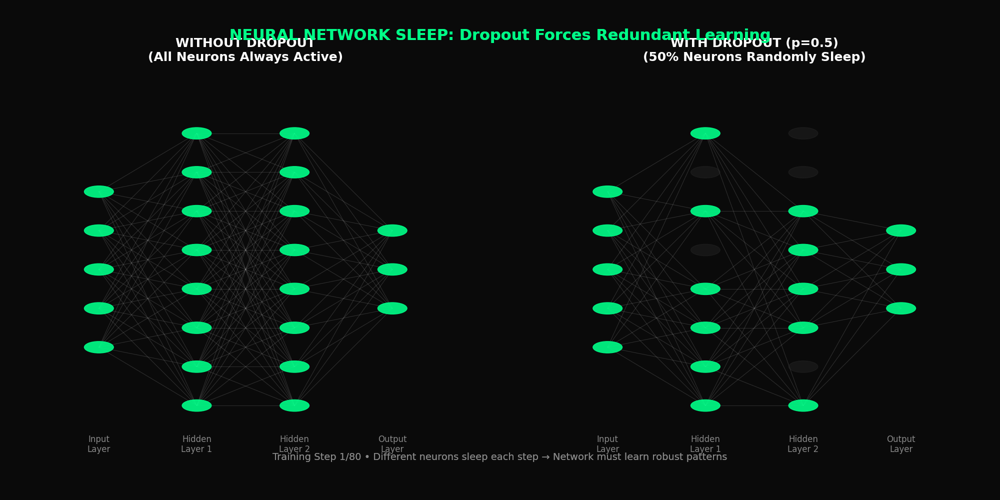


🎬 Generating GIF 2: Overfitting vs Dropout (Training Curves)...
✅ Saved: overfitting_vs_dropout.gif


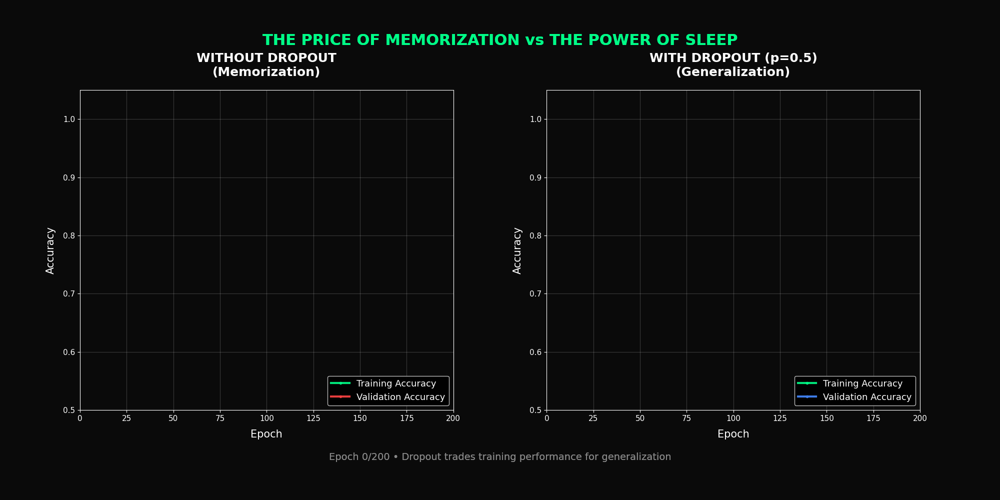


🎬 Generating GIF 3: Decision Boundary Evolution...
Training model without dropout...
Training model with dropout...
✅ Saved: decision_boundary_evolution.gif


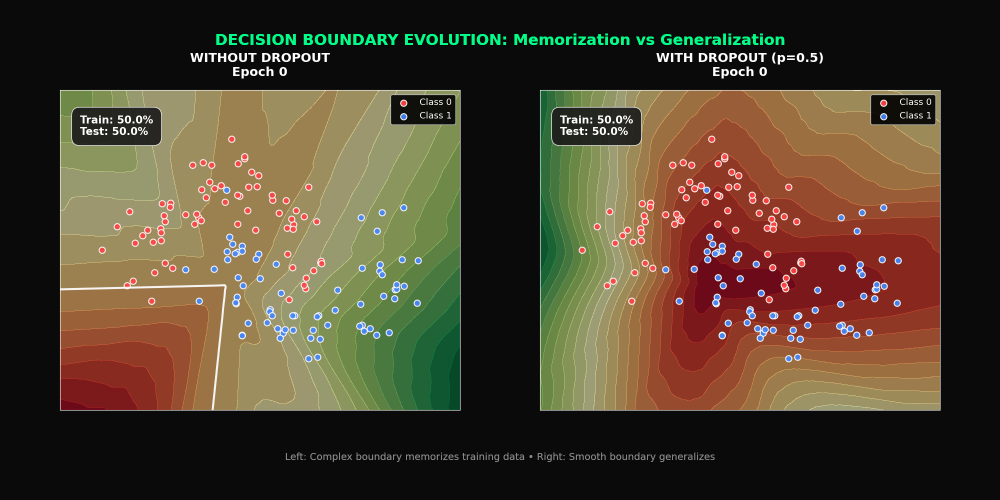


🎬 Generating GIF 4: Monte Carlo Dropout (Uncertainty Estimation)...
✅ Saved: monte_carlo_dropout.gif


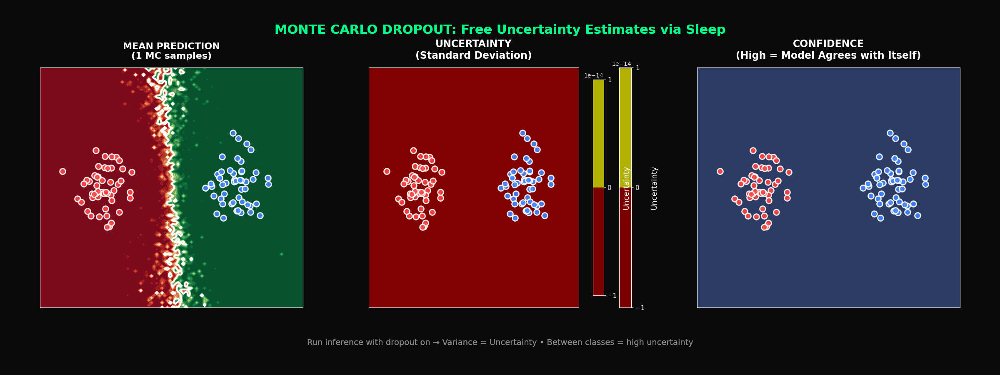


✅ ALL VISUALIZATIONS GENERATED!

📁 Files created:
  1. dropout_mechanism.gif
     → Shows neurons randomly sleeping during training

  2. overfitting_vs_dropout.gif
     → Training curves: memorization vs generalization

  3. decision_boundary_evolution.gif
     → Watch boundaries evolve: complex vs smooth

  4. monte_carlo_dropout.gif
     → Uncertainty estimation via ensemble

💡 These visualizations show:
  • Why randomly "breaking" your network makes it smarter
  • The mathematics of sleep and forgetting
  • How dropout creates an ensemble of networks
  • Free Bayesian uncertainty estimates

🚀 Ready for your Medium article!


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


✅ Files downloading...


In [4]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
from matplotlib.patches import Circle
import tensorflow as tf
from tensorflow import keras
from sklearn.datasets import make_moons, make_circles
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings('ignore')

# Set dark style
plt.style.use('dark_background')

#############################################
# GIF 1: DROPOUT MECHANISM - NEURONS SLEEPING
#############################################

def generate_gif_1_dropout_mechanism():
    """
    Show neural network with neurons randomly turning on/off
    This visualizes what dropout actually does during training
    """
    print("🎬 Generating GIF 1: Dropout Mechanism (Neurons Sleeping)...")

    fig = plt.figure(figsize=(20, 10), facecolor='#0a0a0a')

    # Create subplots with proper spacing
    gs = fig.add_gridspec(1, 2, left=0.05, right=0.95, top=0.85, bottom=0.15, wspace=0.3)
    ax1 = fig.add_subplot(gs[0, 0])
    ax2 = fig.add_subplot(gs[0, 1])

    # Network architecture: 5 input, 8 hidden, 8 hidden, 3 output
    layer_sizes = [5, 8, 8, 3]
    layer_positions = [0, 1, 2, 3]

    n_frames = 80
    dropout_rate = 0.5

    def update(frame):
        ax1.clear()
        ax2.clear()

        # LEFT: No Dropout (all neurons active)
        ax1.set_xlim(-0.5, 3.5)
        ax1.set_ylim(-0.5, 8.5)
        ax1.set_title('WITHOUT DROPOUT\n(All Neurons Always Active)',
                     fontsize=18, color='white', weight='bold', pad=20)
        ax1.axis('off')

        # Draw neurons and connections (no dropout)
        neuron_positions = {}
        for layer_idx, (x_pos, n_neurons) in enumerate(zip(layer_positions, layer_sizes)):
            y_offset = (8 - n_neurons) / 2
            for i in range(n_neurons):
                y_pos = y_offset + i
                neuron_positions[(layer_idx, i)] = (x_pos, y_pos)

                # Draw neuron (always active)
                circle = Circle((x_pos, y_pos), 0.15,
                              color='#00ff88', alpha=0.9, zorder=3)
                ax1.add_patch(circle)

                # Draw connections to previous layer
                if layer_idx > 0:
                    for prev_i in range(layer_sizes[layer_idx-1]):
                        prev_pos = neuron_positions[(layer_idx-1, prev_i)]
                        ax1.plot([prev_pos[0], x_pos], [prev_pos[1], y_pos],
                               'w-', alpha=0.15, linewidth=0.8, zorder=1)

        # Add layer labels with more space
        ax1.text(0, -1.2, 'Input\nLayer', ha='center', fontsize=12, color='#888')
        ax1.text(1, -1.2, 'Hidden\nLayer 1', ha='center', fontsize=12, color='#888')
        ax1.text(2, -1.2, 'Hidden\nLayer 2', ha='center', fontsize=12, color='#888')
        ax1.text(3, -1.2, 'Output\nLayer', ha='center', fontsize=12, color='#888')

        # RIGHT: With Dropout (random neurons inactive)
        ax2.set_xlim(-0.5, 3.5)
        ax2.set_ylim(-0.5, 8.5)
        ax2.set_title('WITH DROPOUT (p=0.5)\n(50% Neurons Randomly Sleep)',
                     fontsize=18, color='white', weight='bold', pad=20)
        ax2.axis('off')

        # Generate random dropout mask (changes each frame)
        np.random.seed(frame)
        dropout_masks = {}
        for layer_idx in [1, 2]:  # Apply dropout to hidden layers only
            mask = np.random.binomial(1, 1-dropout_rate, layer_sizes[layer_idx])
            dropout_masks[layer_idx] = mask

        # Draw neurons and connections (with dropout)
        neuron_positions_dropout = {}
        for layer_idx, (x_pos, n_neurons) in enumerate(zip(layer_positions, layer_sizes)):
            y_offset = (8 - n_neurons) / 2
            for i in range(n_neurons):
                y_pos = y_offset + i
                neuron_positions_dropout[(layer_idx, i)] = (x_pos, y_pos)

                # Check if neuron is active (no dropout in input/output layers)
                is_active = True
                if layer_idx in [1, 2]:
                    is_active = dropout_masks[layer_idx][i] == 1

                # Draw neuron
                if is_active:
                    color = '#00ff88'
                    alpha = 0.9
                else:
                    color = '#333333'  # Sleeping neurons are gray
                    alpha = 0.3

                circle = Circle((x_pos, y_pos), 0.15,
                              color=color, alpha=alpha, zorder=3)
                ax2.add_patch(circle)

                # Draw connections to previous layer
                if layer_idx > 0:
                    for prev_i in range(layer_sizes[layer_idx-1]):
                        prev_pos = neuron_positions_dropout[(layer_idx-1, prev_i)]

                        # Check if both neurons are active
                        prev_active = True
                        if layer_idx - 1 in [1, 2]:
                            prev_active = dropout_masks[layer_idx-1][prev_i] == 1

                        if is_active and prev_active:
                            ax2.plot([prev_pos[0], x_pos], [prev_pos[1], y_pos],
                                   'w-', alpha=0.15, linewidth=0.8, zorder=1)
                        else:
                            ax2.plot([prev_pos[0], x_pos], [prev_pos[1], y_pos],
                                   color='#222222', alpha=0.05, linewidth=0.5, zorder=1)

        # Add layer labels with more space
        ax2.text(0, -1.2, 'Input\nLayer', ha='center', fontsize=12, color='#888')
        ax2.text(1, -1.2, 'Hidden\nLayer 1', ha='center', fontsize=12, color='#888')
        ax2.text(2, -1.2, 'Hidden\nLayer 2', ha='center', fontsize=12, color='#888')
        ax2.text(3, -1.2, 'Output\nLayer', ha='center', fontsize=12, color='#888')

        # Overall title - positioned higher
        fig.text(0.5, 0.92,
                'NEURAL NETWORK SLEEP: Dropout Forces Redundant Learning',
                ha='center', fontsize=22, color='#00ff88', weight='bold')

        # Footer - positioned lower
        fig.text(0.5, 0.08,
                f'Training Step {frame+1}/{n_frames} • Different neurons sleep each step → Network must learn robust patterns',
                ha='center', fontsize=14, color='#888888')

    anim = FuncAnimation(fig, update, frames=n_frames, interval=100, repeat=True)

    writer = PillowWriter(fps=10)
    filename = 'dropout_mechanism.gif'
    anim.save(filename, writer=writer, dpi=100)
    plt.close()

    print(f"✅ Saved: {filename}")
    from IPython.display import Image, display
    display(Image(filename))
    return filename


#############################################
# GIF 2: OVERFITTING VS DROPOUT - TRAINING CURVES
#############################################

def generate_gif_2_overfitting_curves():
    """
    Show training curves evolving: overfitting without dropout vs.
    generalization with dropout
    """
    print("🎬 Generating GIF 2: Overfitting vs Dropout (Training Curves)...")

    # Simulate training curves
    epochs = 200

    # Without dropout: overfits
    train_acc_no_dropout = 1 - 0.4*np.exp(-np.arange(epochs)/20)
    val_acc_no_dropout = 0.85 - 0.05*np.arange(epochs)/epochs  # Degrades

    # With dropout: generalizes
    train_acc_dropout = 1 - 0.5*np.exp(-np.arange(epochs)/30)  # Slower learning
    val_acc_dropout = 0.7 + 0.28*(1 - np.exp(-np.arange(epochs)/25))  # Improves!

    # Add some noise
    np.random.seed(42)
    train_acc_no_dropout += np.random.randn(epochs)*0.01
    val_acc_no_dropout += np.random.randn(epochs)*0.015
    train_acc_dropout += np.random.randn(epochs)*0.01
    val_acc_dropout += np.random.randn(epochs)*0.015

    fig = plt.figure(figsize=(20, 10), facecolor='#0a0a0a')

    # Create subplots with proper spacing
    gs = fig.add_gridspec(1, 2, left=0.08, right=0.92, top=0.82, bottom=0.18, wspace=0.25)
    ax1 = fig.add_subplot(gs[0, 0])
    ax2 = fig.add_subplot(gs[0, 1])

    n_frames = 100

    def update(frame):
        ax1.clear()
        ax2.clear()

        # Calculate how many epochs to show
        current_epoch = int((frame / n_frames) * epochs)

        # LEFT: Without Dropout
        ax1.plot(np.arange(current_epoch), train_acc_no_dropout[:current_epoch],
                'o-', color='#00ff88', linewidth=3, markersize=3, label='Training Accuracy', alpha=0.9)
        ax1.plot(np.arange(current_epoch), val_acc_no_dropout[:current_epoch],
                'o-', color='#ff4444', linewidth=3, markersize=3, label='Validation Accuracy', alpha=0.9)

        ax1.set_xlim(0, epochs)
        ax1.set_ylim(0.5, 1.05)
        ax1.set_xlabel('Epoch', fontsize=15, color='white', labelpad=10)
        ax1.set_ylabel('Accuracy', fontsize=15, color='white', labelpad=10)
        ax1.set_title('WITHOUT DROPOUT\n(Memorization)',
                     fontsize=18, color='white', weight='bold', pad=20)
        ax1.legend(loc='lower right', fontsize=13, framealpha=0.9)
        ax1.grid(True, alpha=0.2)
        ax1.set_facecolor('#0a0a0a')
        ax1.tick_params(colors='white', labelsize=11)

        if current_epoch > 50:
            gap = train_acc_no_dropout[current_epoch-1] - val_acc_no_dropout[current_epoch-1]
            ax1.text(0.05, 0.92, f'Overfit Gap: {gap:.1%}',
                    transform=ax1.transAxes, fontsize=15,
                    color='#ff4444', weight='bold', va='top',
                    bbox=dict(boxstyle='round', facecolor='#1a1a1a', alpha=0.9, pad=0.8))

        # RIGHT: With Dropout
        ax2.plot(np.arange(current_epoch), train_acc_dropout[:current_epoch],
                'o-', color='#00ff88', linewidth=3, markersize=3, label='Training Accuracy', alpha=0.9)
        ax2.plot(np.arange(current_epoch), val_acc_dropout[:current_epoch],
                'o-', color='#4488ff', linewidth=3, markersize=3, label='Validation Accuracy', alpha=0.9)

        ax2.set_xlim(0, epochs)
        ax2.set_ylim(0.5, 1.05)
        ax2.set_xlabel('Epoch', fontsize=15, color='white', labelpad=10)
        ax2.set_ylabel('Accuracy', fontsize=15, color='white', labelpad=10)
        ax2.set_title('WITH DROPOUT (p=0.5)\n(Generalization)',
                     fontsize=18, color='white', weight='bold', pad=20)
        ax2.legend(loc='lower right', fontsize=13, framealpha=0.9)
        ax2.grid(True, alpha=0.2)
        ax2.set_facecolor('#0a0a0a')
        ax2.tick_params(colors='white', labelsize=11)

        if current_epoch > 150:
            final_val = val_acc_dropout[current_epoch-1]
            ax2.text(0.05, 0.92, f'Val Acc: {final_val:.1%}\n(Better than training!)',
                    transform=ax2.transAxes, fontsize=15,
                    color='#4488ff', weight='bold', va='top',
                    bbox=dict(boxstyle='round', facecolor='#1a1a1a', alpha=0.9, pad=0.8))

        # Overall title - positioned higher
        fig.text(0.5, 0.91,
                'THE PRICE OF MEMORIZATION vs THE POWER OF SLEEP',
                ha='center', fontsize=22, color='#00ff88', weight='bold')

        # Footer - positioned lower
        fig.text(0.5, 0.08,
                f'Epoch {current_epoch}/{epochs} • Dropout trades training performance for generalization',
                ha='center', fontsize=14, color='#888888')

    anim = FuncAnimation(fig, update, frames=n_frames, interval=80, repeat=True)

    writer = PillowWriter(fps=12)
    filename = 'overfitting_vs_dropout.gif'
    anim.save(filename, writer=writer, dpi=100)
    plt.close()

    print(f"✅ Saved: {filename}")
    from IPython.display import Image, display
    display(Image(filename))
    return filename


#############################################
# GIF 3: DECISION BOUNDARY EVOLUTION
#############################################

def generate_gif_3_decision_boundary():
    """
    Show how decision boundaries evolve during training
    Without dropout: complex, wiggly (overfits)
    With dropout: smooth, robust (generalizes)
    """
    print("🎬 Generating GIF 3: Decision Boundary Evolution...")

    # Generate data
    np.random.seed(42)
    X, y = make_moons(n_samples=200, noise=0.2)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

    # Create models
    def create_model(use_dropout=False):
        model = keras.Sequential()
        model.add(keras.layers.Dense(100, activation='relu', input_shape=(2,)))
        if use_dropout:
            model.add(keras.layers.Dropout(0.5))
        model.add(keras.layers.Dense(100, activation='relu'))
        if use_dropout:
            model.add(keras.layers.Dropout(0.5))
        model.add(keras.layers.Dense(100, activation='relu'))
        if use_dropout:
            model.add(keras.layers.Dropout(0.5))
        model.add(keras.layers.Dense(1, activation='sigmoid'))

        model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
        return model

    # Train models and save weights at different epochs
    epochs_to_save = list(range(0, 201, 10))

    print("Training model without dropout...")
    model_no_dropout = create_model(use_dropout=False)
    weights_no_dropout = {}
    weights_no_dropout[0] = [w.copy() for w in model_no_dropout.get_weights()]

    for epoch in range(1, 201):
        model_no_dropout.fit(X_train, y_train, epochs=1, verbose=0, batch_size=32)
        if epoch in epochs_to_save:
            weights_no_dropout[epoch] = [w.copy() for w in model_no_dropout.get_weights()]

    print("Training model with dropout...")
    model_dropout = create_model(use_dropout=True)
    weights_dropout = {}
    weights_dropout[0] = [w.copy() for w in model_dropout.get_weights()]

    for epoch in range(1, 201):
        model_dropout.fit(X_train, y_train, epochs=1, verbose=0, batch_size=32)
        if epoch in epochs_to_save:
            weights_dropout[epoch] = [w.copy() for w in model_dropout.get_weights()]

    # Create grid for decision boundary
    x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
    y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200),
                         np.linspace(y_min, y_max, 200))
    grid_points = np.c_[xx.ravel(), yy.ravel()]

    # Create animation
    fig = plt.figure(figsize=(20, 10), facecolor='#0a0a0a')

    # Create subplots with proper spacing
    gs = fig.add_gridspec(1, 2, left=0.06, right=0.94, top=0.82, bottom=0.18, wspace=0.20)
    ax1 = fig.add_subplot(gs[0, 0])
    ax2 = fig.add_subplot(gs[0, 1])

    n_frames = len(epochs_to_save)

    def update(frame_idx):
        ax1.clear()
        ax2.clear()

        epoch = epochs_to_save[frame_idx]

        # LEFT: Without Dropout
        model_no_dropout.set_weights(weights_no_dropout[epoch])
        Z_no_dropout = model_no_dropout.predict(grid_points, verbose=0).reshape(xx.shape)

        contour1 = ax1.contourf(xx, yy, Z_no_dropout, levels=20, cmap='RdYlGn', alpha=0.6)
        ax1.contour(xx, yy, Z_no_dropout, levels=[0.5], colors='white', linewidths=3, alpha=0.9)

        # Plot data
        ax1.scatter(X_train[y_train==0, 0], X_train[y_train==0, 1],
                   c='#ff4444', s=80, edgecolors='white', linewidth=1.5, alpha=0.9, label='Class 0')
        ax1.scatter(X_train[y_train==1, 0], X_train[y_train==1, 1],
                   c='#4488ff', s=80, edgecolors='white', linewidth=1.5, alpha=0.9, label='Class 1')

        ax1.set_xlim(x_min, x_max)
        ax1.set_ylim(y_min, y_max)
        ax1.set_title(f'WITHOUT DROPOUT\nEpoch {epoch}',
                     fontsize=18, color='white', weight='bold', pad=20)
        ax1.legend(loc='upper right', fontsize=13, framealpha=0.9)
        ax1.set_facecolor('#0a0a0a')
        ax1.set_xticks([])
        ax1.set_yticks([])

        # Calculate accuracy
        train_pred = (model_no_dropout.predict(X_train, verbose=0) > 0.5).astype(int).flatten()
        test_pred = (model_no_dropout.predict(X_test, verbose=0) > 0.5).astype(int).flatten()
        train_acc = (train_pred == y_train).mean()
        test_acc = (test_pred == y_test).mean()

        ax1.text(0.05, 0.92, f'Train: {train_acc:.1%}\nTest: {test_acc:.1%}',
                transform=ax1.transAxes, fontsize=15, color='white', weight='bold', va='top',
                bbox=dict(boxstyle='round', facecolor='#1a1a1a', alpha=0.9, pad=0.8))

        # RIGHT: With Dropout
        model_dropout.set_weights(weights_dropout[epoch])
        Z_dropout = model_dropout.predict(grid_points, verbose=0).reshape(xx.shape)

        contour2 = ax2.contourf(xx, yy, Z_dropout, levels=20, cmap='RdYlGn', alpha=0.6)
        ax2.contour(xx, yy, Z_dropout, levels=[0.5], colors='white', linewidths=3, alpha=0.9)

        # Plot data
        ax2.scatter(X_train[y_train==0, 0], X_train[y_train==0, 1],
                   c='#ff4444', s=80, edgecolors='white', linewidth=1.5, alpha=0.9, label='Class 0')
        ax2.scatter(X_train[y_train==1, 0], X_train[y_train==1, 1],
                   c='#4488ff', s=80, edgecolors='white', linewidth=1.5, alpha=0.9, label='Class 1')

        ax2.set_xlim(x_min, x_max)
        ax2.set_ylim(y_min, y_max)
        ax2.set_title(f'WITH DROPOUT (p=0.5)\nEpoch {epoch}',
                     fontsize=18, color='white', weight='bold', pad=20)
        ax2.legend(loc='upper right', fontsize=13, framealpha=0.9)
        ax2.set_facecolor('#0a0a0a')
        ax2.set_xticks([])
        ax2.set_yticks([])

        # Calculate accuracy
        train_pred = (model_dropout.predict(X_train, verbose=0) > 0.5).astype(int).flatten()
        test_pred = (model_dropout.predict(X_test, verbose=0) > 0.5).astype(int).flatten()
        train_acc = (train_pred == y_train).mean()
        test_acc = (test_pred == y_test).mean()

        ax2.text(0.05, 0.92, f'Train: {train_acc:.1%}\nTest: {test_acc:.1%}',
                transform=ax2.transAxes, fontsize=15, color='white', weight='bold', va='top',
                bbox=dict(boxstyle='round', facecolor='#1a1a1a', alpha=0.9, pad=0.8))

        # Overall title - positioned higher
        fig.text(0.5, 0.91,
                'DECISION BOUNDARY EVOLUTION: Memorization vs Generalization',
                ha='center', fontsize=22, color='#00ff88', weight='bold')

        # Footer - positioned lower
        fig.text(0.5, 0.08,
                'Left: Complex boundary memorizes training data • Right: Smooth boundary generalizes',
                ha='center', fontsize=14, color='#888888')

    anim = FuncAnimation(fig, update, frames=n_frames, interval=200, repeat=True)

    writer = PillowWriter(fps=5)
    filename = 'decision_boundary_evolution.gif'
    anim.save(filename, writer=writer, dpi=100)
    plt.close()

    print(f"✅ Saved: {filename}")
    from IPython.display import Image, display
    display(Image(filename))
    return filename


#############################################
# GIF 4: MONTE CARLO DROPOUT - UNCERTAINTY
#############################################

def generate_gif_4_monte_carlo_dropout():
    """
    Show Monte Carlo dropout: running inference multiple times
    with dropout still active to get uncertainty estimates
    """
    print("🎬 Generating GIF 4: Monte Carlo Dropout (Uncertainty Estimation)...")

    # Generate data with uncertainty region
    np.random.seed(42)
    X_certain = np.random.randn(100, 2) * 0.5
    X_certain[:50, 0] -= 2
    X_certain[50:, 0] += 2
    y_certain = np.hstack([np.zeros(50), np.ones(50)])

    # Train model with dropout
    model = keras.Sequential([
        keras.layers.Dense(50, activation='relu', input_shape=(2,)),
        keras.layers.Dropout(0.5),
        keras.layers.Dense(50, activation='relu'),
        keras.layers.Dropout(0.5),
        keras.layers.Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy')
    model.fit(X_certain, y_certain, epochs=200, verbose=0, batch_size=16)

    # Create grid
    x_min, x_max = -4, 4
    y_min, y_max = -3, 3
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100),
                         np.linspace(y_min, y_max, 100))
    grid_points = np.c_[xx.ravel(), yy.ravel()]

    # Monte Carlo samples
    n_samples = 50

    fig = plt.figure(figsize=(24, 9), facecolor='#0a0a0a')

    # Create subplots with proper spacing
    gs = fig.add_gridspec(1, 3, left=0.04, right=0.96, top=0.82, bottom=0.18, wspace=0.25)
    ax1 = fig.add_subplot(gs[0, 0])
    ax2 = fig.add_subplot(gs[0, 1])
    ax3 = fig.add_subplot(gs[0, 2])

    n_frames = 60

    def update(frame):
        ax1.clear()
        ax2.clear()
        ax3.clear()

        # Number of MC samples to show
        current_samples = min(frame + 1, n_samples)

        # Run Monte Carlo dropout
        predictions = []
        for _ in range(current_samples):
            pred = model(grid_points, training=True).numpy()  # Keep dropout on!
            predictions.append(pred)

        predictions = np.array(predictions)
        mean_pred = predictions.mean(axis=0).reshape(xx.shape)
        std_pred = predictions.std(axis=0).reshape(xx.shape)

        # LEFT: Mean Prediction
        contour1 = ax1.contourf(xx, yy, mean_pred, levels=20, cmap='RdYlGn', alpha=0.7)
        ax1.contour(xx, yy, mean_pred, levels=[0.5], colors='white', linewidths=3)

        ax1.scatter(X_certain[y_certain==0, 0], X_certain[y_certain==0, 1],
                   c='#ff4444', s=100, edgecolors='white', linewidth=2, alpha=0.9)
        ax1.scatter(X_certain[y_certain==1, 0], X_certain[y_certain==1, 1],
                   c='#4488ff', s=100, edgecolors='white', linewidth=2, alpha=0.9)

        ax1.set_xlim(x_min, x_max)
        ax1.set_ylim(y_min, y_max)
        ax1.set_title(f'MEAN PREDICTION\n({current_samples} MC samples)',
                     fontsize=16, color='white', weight='bold', pad=15)
        ax1.set_facecolor('#0a0a0a')
        ax1.set_xticks([])
        ax1.set_yticks([])

        # MIDDLE: Uncertainty (Std Dev)
        contour2 = ax2.contourf(xx, yy, std_pred, levels=20, cmap='hot', alpha=0.7)

        ax2.scatter(X_certain[y_certain==0, 0], X_certain[y_certain==0, 1],
                   c='#ff4444', s=100, edgecolors='white', linewidth=2, alpha=0.9)
        ax2.scatter(X_certain[y_certain==1, 0], X_certain[y_certain==1, 1],
                   c='#4488ff', s=100, edgecolors='white', linewidth=2, alpha=0.9)

        ax2.set_xlim(x_min, x_max)
        ax2.set_ylim(y_min, y_max)
        ax2.set_title('UNCERTAINTY\n(Standard Deviation)',
                     fontsize=17, color='white', weight='bold', pad=15)
        ax2.set_facecolor('#0a0a0a')
        ax2.set_xticks([])
        ax2.set_yticks([])

        # Add colorbar for uncertainty with better positioning
        cbar = plt.colorbar(contour2, ax=ax2, fraction=0.046, pad=0.06)
        cbar.set_label('Uncertainty', color='white', fontsize=13, labelpad=10)
        cbar.ax.yaxis.set_tick_params(color='white', labelsize=11)
        plt.setp(plt.getp(cbar.ax.axes, 'yticklabels'), color='white')

        # RIGHT: Confidence (1 - Uncertainty)
        confidence = 1 - std_pred
        contour3 = ax3.contourf(xx, yy, confidence, levels=20, cmap='viridis', alpha=0.7)

        ax3.scatter(X_certain[y_certain==0, 0], X_certain[y_certain==0, 1],
                   c='#ff4444', s=100, edgecolors='white', linewidth=2, alpha=0.9)
        ax3.scatter(X_certain[y_certain==1, 0], X_certain[y_certain==1, 1],
                   c='#4488ff', s=100, edgecolors='white', linewidth=2, alpha=0.9)

        ax3.set_xlim(x_min, x_max)
        ax3.set_ylim(y_min, y_max)
        ax3.set_title('CONFIDENCE\n(High = Model Agrees with Itself)',
                     fontsize=17, color='white', weight='bold', pad=15)
        ax3.set_facecolor('#0a0a0a')
        ax3.set_xticks([])
        ax3.set_yticks([])

        # Overall title - positioned higher
        fig.text(0.5, 0.91,
                'MONTE CARLO DROPOUT: Free Uncertainty Estimates via Sleep',
                ha='center', fontsize=22, color='#00ff88', weight='bold')

        # Footer - positioned lower
        fig.text(0.5, 0.08,
                'Run inference with dropout on → Variance = Uncertainty • Between classes = high uncertainty',
                ha='center', fontsize=14, color='#888888')

    anim = FuncAnimation(fig, update, frames=n_frames, interval=100, repeat=True)

    writer = PillowWriter(fps=10)
    filename = 'monte_carlo_dropout.gif'
    anim.save(filename, writer=writer, dpi=100)
    plt.close()

    print(f"✅ Saved: {filename}")
    from IPython.display import Image, display
    display(Image(filename))
    return filename


#############################################
# MAIN EXECUTION
#############################################

if __name__ == "__main__":
    print("=" * 70)
    print("DROPOUT AS NEURAL NETWORK SLEEP")
    print("Generating 4 stunning visualizations for Medium article")
    print("=" * 70)
    print()

    # Generate all GIFs
    gif1 = generate_gif_1_dropout_mechanism()
    print()

    gif2 = generate_gif_2_overfitting_curves()
    print()

    gif3 = generate_gif_3_decision_boundary()
    print()

    gif4 = generate_gif_4_monte_carlo_dropout()

    print()
    print("=" * 70)
    print("✅ ALL VISUALIZATIONS GENERATED!")
    print("=" * 70)
    print()
    print("📁 Files created:")
    print("  1. dropout_mechanism.gif")
    print("     → Shows neurons randomly sleeping during training")
    print()
    print("  2. overfitting_vs_dropout.gif")
    print("     → Training curves: memorization vs generalization")
    print()
    print("  3. decision_boundary_evolution.gif")
    print("     → Watch boundaries evolve: complex vs smooth")
    print()
    print("  4. monte_carlo_dropout.gif")
    print("     → Uncertainty estimation via ensemble")
    print()
    print("💡 These visualizations show:")
    print('  • Why randomly "breaking" your network makes it smarter')
    print("  • The mathematics of sleep and forgetting")
    print("  • How dropout creates an ensemble of networks")
    print("  • Free Bayesian uncertainty estimates")
    print()
    print("🚀 Ready for your Medium article!")
    print("=" * 70)

    # Download in Colab
    try:
        from google.colab import files
        files.download('dropout_mechanism.gif')
        files.download('overfitting_vs_dropout.gif')
        files.download('decision_boundary_evolution.gif')
        files.download('monte_carlo_dropout.gif')
        print()
        print("✅ Files downloading...")
    except:
        print()
        print("📁 Files saved to current directory")
        print("   (Not in Colab - download manually)")
